# Uploading Project Data

In [1]:
# # how to Unizip the file present in drive

# !unzip "drive/MyDrive/Dog vision/dog-breed-identification.zip" -d "drive/MyDrive/Dog vision/"

# Importing TensorFlow 2

# 🐶 End-to-End Multi-class Dog Breed Classification

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow Hub.

## 1. Problem

Identifying the breed of dog given an image of a dog 

When I'm sitting at the cafe and I take a photo of a dog, I want to know what breed of dog it is

## 2. Data 

The data we're using is from Kaggle's dog breed identification competition

visit: kaggle's dog breed Prediction Competetion.

##  3. Evaluation

The evaluation is file with prediction probabilities for each dog of test image 

visit kaggle


## 4. Features

Some information about the data:
* We're dealing with image (unstructured data) so it's probably best we use deep learning/transfer learning.

*There are 120 breeds of dog (this means there are 120 different classes).

* There are around 10,000+ images int the training set
*There are around 10,000+ images in the set( these images have no labels, because we'll want to predict them.

# Get our workspace ready

* Import TensorFlow 2.x ✅
* Import TensorFlow Hub✅
* Make sure we're using a GPU✅

In [2]:
from tensorflow.python.framework.config import list_physical_devices
# Import Tensor Flow into Colab

import tensorflow as tf
import tensorflow_hub as hub
print("TF version:", tf.__version__) # to check the verion to tensor Flow
print("TF Hub version:", hub.__version__)

# Check for GPU availability
print("GPU", "available (Yesss!!!)" if tf.config.list_physical_devices ("GPU") else "not available :(" )

TF version: 2.8.2
TF Hub version: 0.12.0
GPU available (Yesss!!!)


# Using A GPU


Change runtime type-> Hardware Accelerator-> choose GPU.

# Loading Our Data Labels

## Getting our data ready (turing into Tensors)

With all machine learning models, our data has to be in numerical format. So that's what we'll be doing first. Turning our images into Tensors (numerical representation)

Let's start by accesiing our data and checking out the labels


In [3]:
# Checkout the labels of our data 

import pandas as pd

labels_csv = pd.read_csv("drive/MyDrive/Dog vision/labels.csv")
# labels_csv.describe()
# labels_csv.head()
# Note if you want to to print more more than two details in same cell use print fuction
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [4]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


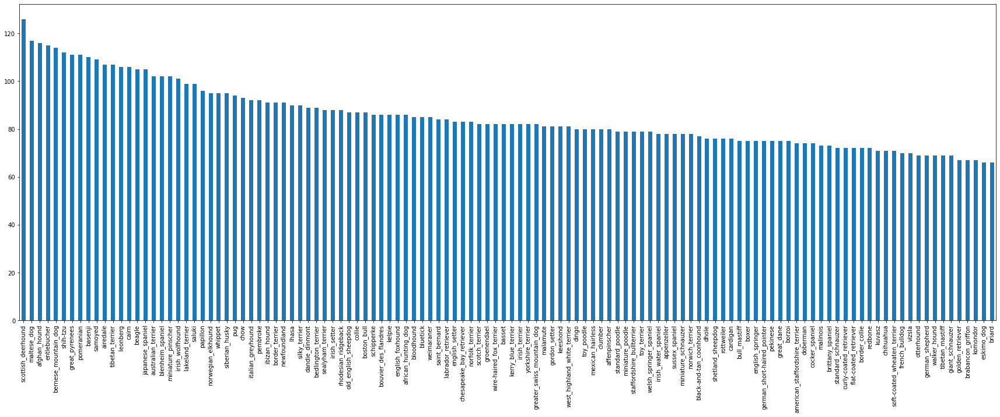

In [5]:
# How many images are there of each breed?
labels_csv["breed"].value_counts().plot.bar(figsize=(30,10)); # also visualizing it 

In [6]:
labels_csv.breed.value_counts().mean()

85.18333333333334

Google rocommend you should have minimum of 10-100  example images per class to classify any category.

# Preparing The Images

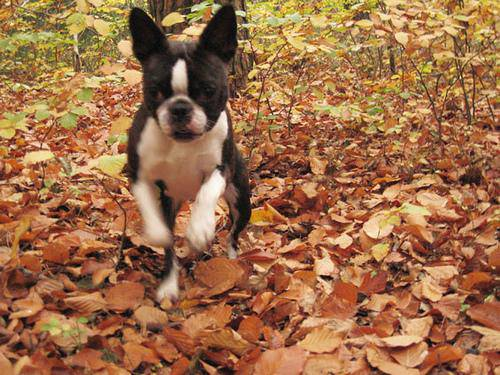

In [7]:
# Let's view an image we can also do this using matplotib.

from IPython.display import Image

Image("drive/MyDrive/Dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

### Gettinng images and their labels

Let's get a list of all of our image file pathname

In [8]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [9]:
# Create pathnames from image ID's


# **create a list of fname fo fname in label_csv id column
filenames= ["drive/MyDrive/Dog vision/train/"+fname +".jpg" for fname in labels_csv["id"]]

# check the first 10
filenames[:10]

['drive/MyDrive/Dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [10]:
# Check whether number of filemanes macthes number of actual image files

import os

if len(os.listdir("drive/MyDrive/Dog vision/train")) == len(filenames):
  print("Filenames match actual amout of file !!! Proceed")
else:
  print("Filenames do not mactch actual amout of files, check the target directory.")

Filenames match actual amout of file !!! Proceed


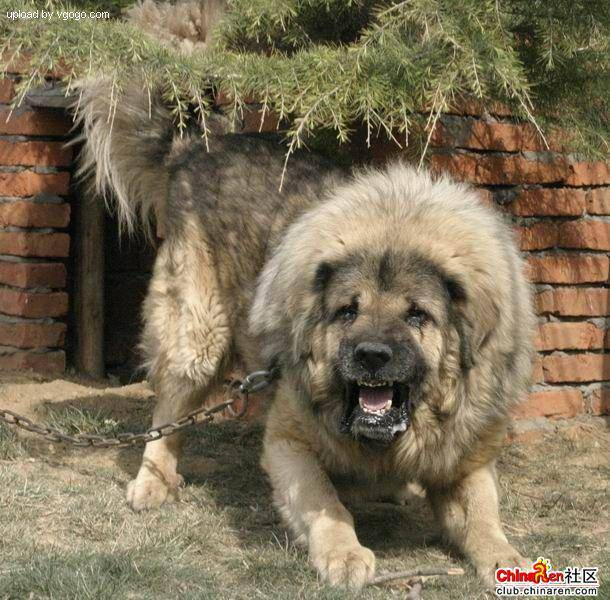

In [11]:
# One more check 

Image(filenames[9000])

In [12]:
labels_csv.breed[9000]

'tibetan_mastiff'

# Turning Data Labels Into Numbers

Sice we've now got our training image filepaths in a list. let's prepare our label

In [13]:
labels = labels_csv.breed
labels

0                     boston_bull
1                           dingo
2                        pekinese
3                        bluetick
4                golden_retriever
                   ...           
10217                      borzoi
10218              dandie_dinmont
10219                    airedale
10220          miniature_pinscher
10221    chesapeake_bay_retriever
Name: breed, Length: 10222, dtype: object

In [14]:
# adding labels to numpy arrays

import numpy as np
labels = labels_csv["breed"].to_numpy()
# lables = np.array(labesl) # also converts into numpy arry
labels_csv

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
...,...,...
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher


In [15]:
len(labels)

10222

In [16]:
# See if number of labels matches the number of filenames

if len(labels)== len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels dose not match number of filenames, check data directory")

Number of labels matches number of filenames!


A machine learnig or deep learning model can't take strings so we must convert all the data into numbers

In [17]:
# find the unique label values

unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [18]:
len(unique_breeds)

120

In [19]:
# Trun a single label into an array of booleans
print(labels[0])
labels[0]==unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [20]:
# Trun every labels into into a boolean array Just like oneHotencoder

boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [21]:
len(labels)

10222

In [22]:
# Example: Trurnig  boolean array into integers
print(labels[0]) # original label

print(np.where(unique_breeds==labels[0])) # index where label occurs
print(boolean_labels[0].argmax) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) #there will be a 1 where the sample label occurs

boston_bull
(array([19]),)
<built-in method argmax of numpy.ndarray object at 0x7f73560b8090>
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [23]:
print(labels[2])
print(boolean_labels[2].astype(int))

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


# Creating Our Own Validation Set

In [24]:
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [25]:
filenames[:10]

['drive/MyDrive/Dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

## Creating our own validation set

Since the dataset from kaggle dosen't come with validation set we're going to create our own

In [26]:
## Setup X & y variables

X = filenames
y= boolean_labels

In [27]:
# Don't take your whole data for training you model just take the portion of it and
# remebers we should minimize the time between experiments

len(X)

10222

We're going to start off experimeting with ~ 1000 images and increase as needed

In [28]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [29]:
# Let's split our data into train and validation sets
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGEs

X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

# checking the data is in right shape
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [30]:
# Let's have a geez at the training data

X_train[:5], y_train[:2]

(['drive/MyDrive/Dog vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog vision/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/MyDrive/Dog vision/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/MyDrive/Dog vision/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/MyDrive/Dog vision/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, 

# Preprocess Images

## Turning images into Tensors

To preprocess our image into Tensors we're going to write a fuction which does a few things:


1. Take an image filepath as input
2. Use TensorFlow to read the file and save t to variable `image`
3. Turn our `image`(a jpg) into Tensors
4. Resize the `image` to be a shpe of (244,244)
5. Retrun the modified `image`

Before we do, let's see what importing images look like

In [31]:
filenames[:10]

['drive/MyDrive/Dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [32]:
# Convert image to Numpy Array

from matplotlib.pyplot import imread
image = imread(filenames[42]) # input take as path of image
image.shape



(257, 350, 3)

In [33]:
image[:2]

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)

In [34]:
image.max(), image.min()

(255, 0)

In [35]:
# conveting the numpy array into tensors (they are differnt than numy arrays)

tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

# Preprocess Images 2

Now we've seen what an image looks like as a Tensor let's make a function to preprocess them.

1. Take an image filepath as input
2. Use TensorFlow to read the file and save t to variable `image`
3. Turn our `image`(a jpg) into Tensors
4. Normalize our image (convert color channela values from 0-255 to 0-1)
4. Resize the `image` to be a shpe of (244,244)
5. Retrun the modified `image`


In [36]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image file path and turns the image into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

In [37]:
# tensor= tf.io.read_file(filenames[26])
# tensor

# Turning Data Into Batches

TensorFlow like the data in the form of batches (also called mini batch aka small poetion of your data) 32 is the defualt batch size in deep learning

## Turning our data into batches

Why turn our data into baches?

Let's say you're trying to process 10,000+ image in one go.. they all might not fit into memory of GPU.

So that's why we do about 32 (this is the batch size if need be).

In order to use TensorFlow effectively, we nee our data in th form of Tensor Tuple which look like this: `(image, label)`

In [38]:
# Create a simple fuction to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the assosciate label,
  processe the image and returns a tuple of (image,label).
  """
  image= process_image(image_path)
  return image,label

In [39]:
# Demo of above
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

# Turning Data Into Batches 2

Now we've got  a way to turn our data into tuple of Tensors ing the form: `(image, label)`. let's make a fuction to turn all of our data (X & y)
into bataches!

In [40]:
# # Define the batch size, 32 is good start

# BATCH_SIZE =32

# # Create a fuction to turn data into batches
# def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data= False, test_data=False):
#   """
#   Creates batches of data our of image (X) and label (y) pairs.
#   Shuffles the data if it's training data but dosen't shuffle if it's validation data
#   Also accept test data as input (no labels)
#   """

#   # If the data is a test dataset , we probably don't have labels
#   if test_data:
#     print("Creating test data batches...")
#     data = tf.data.Dataset.from_tensor_slices(tf.constan(X)) # only fliepaths (no labels)
#     data_batch = data.map(process_image).batch(BATCH_SIZE)
#     return data_batch

# # if the data is a valid dataset, we don't need to shuffle it
#   elif valid_data:
#     print("Createng validation data batches..")
#     data= tf.data.Dataset.from_tensor_slices((tf.constant(X),# filepath
#                                               tf.constant(y))) #labels
#     data_batch= data.map(get_image_label).batch(BATCH_SIZE)
#     return data_batch

#   else:
#     print("Creating trainign data batches...")
#     # Turn file path and labels into Tensors
#     data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
#                                              tf.constant(y)))
#     # Shuffling pathnames and labels before mapping image processor fuction is faster than shuffling images
#     data= data.shuffle(buffer_size=len(X))
#     # if is simple to shuffle file path as comparision original images

#     # create (image,label) tuples (this also turns the image path into a preprecessed image)
#     data = data.map(process_image)

#     # Trurn the training data into batches
#     data_batch= data.batch(BATCH_SIZE)

#     return data_batch

In [41]:
# Define the batch size, 32 is a good start
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples (this also turns the iamge path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [42]:
# create training and validation data bathces

train_data= create_data_batches(X_train, y_train)
val_data= create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [43]:
# Check out the differen attributes of our data batches

train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

# Visualizing Our Data


Our data is now in batches, however, these can be a little hard to understand/comprehend, let's visualize them

In [44]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image 
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis("off")

In [45]:
train_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [46]:
# Extracting the data from batches because they are differnt types of 
# datastructure and so we need to make iterators to iterate over batches and
# return the next element

# train_images, train_labels=next(train_data.as_numpy_iterator())
# train_images[:5], train_labels

In [47]:
unique_breeds[y[0].argmax()]

'boston_bull'

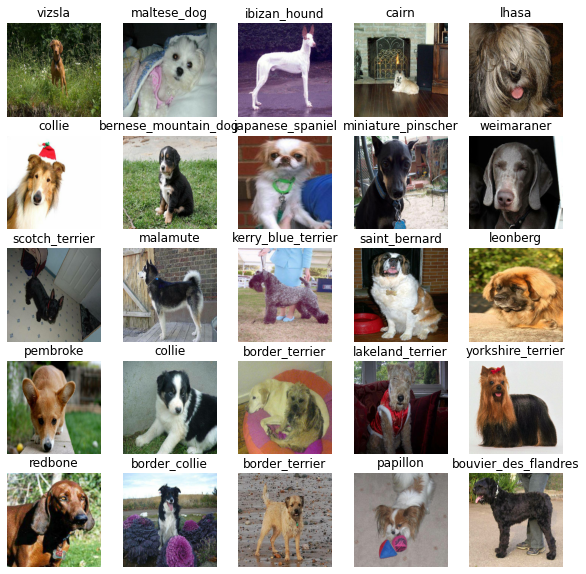

In [48]:
# Now let's visualize the data in a trainig batch
train_images, train_labels=next(train_data.as_numpy_iterator())
show_25_images(train_images,train_labels)

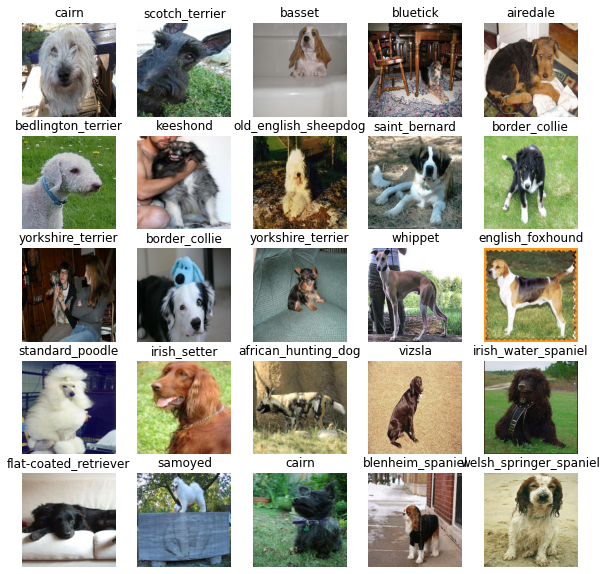

In [49]:
# Now let's visualize the data in a trainin batch
val_images, val_labels= next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

# Preparing Our Inputs and Outputs

## Building a model 

Before we buil a model, there are a few things we need to define:

* The input shape (our images, shape, in the form of Tensors) to our model.
* The output shpae (image labels, in the form of Tensors) our model.
* The URL of the model we want to use.
  From TensorFlow Hub 

# Building A Deep Learning Model

You can get Pretrained Deep Learning model on:-

* TensorFlow Hub
* Pytorch Hub
* Model Zoo
* Papers with Code
* Andrew kaparthy Tesla Self Driving Cars Model

In [51]:
# Setup input shape to the model

INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE,3] # batch,height,width, colour channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds)

# Setup modlel URL form TesorFlow Hub
MODEL_URL= "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

# Building A Deep Learning Model 2


Now we've got our inputs, outputs and model ready to go.
Let's put them together into keras deep learning model!

Knowing this, let's create a fuction which:

* Takes the input shape, output shape and the model we've chosen as parameters.
* Define the layers in a Keras model in sequential fashion (do this first, then, the that)
* Compiles the model (says it should be evaluated and improved).
* Builds the model (tells the model the input shape it'll be getting).
* Returns the model.

All of these steps can be found on keras devs

In [52]:
# Create a fuction which builds a Keras model

def create_model(input_shape= INPUT_SHAPE, Output_shape=OUTPUT_SHAPE, mdoel_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model= tf.keras.Sequential([
     hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
     tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                           activation="softmax") # Layer 2 (output Layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer= tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

In [53]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


Explaination of model.summuary

* Total params: 5,552,953
* Trainable params: 120,240 these are the paattern we need to train 
* Non-trainable params: 5,432,713  Already trained so we don't need to train those features this is the benfit of transfer learning

# Evaluating Our Model

## Creating Callbaks

Callbacks are helper fuction a model can use during training to do such things as save its progress, check its progress or stop training early if a mdoel stop improving (check all the things if model trained for weeks)

We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from trainning for tool long

### TensorBoard Callback

To setup a TensorBoard Callback, we nee to do 3 things
1. Load the TensorBoard notebook extension
2. Create a TesorBoard call which is able to save logs to a directory and pass it to our model's `fir()` fuction.
3. Visualize our models training logs with the `%tensorboard` magic fuction (we'll do this after model trianing)

In [54]:
# Load TensorBoard notebook extension
%load_ext tensorboard 

In [55]:
import datetime

# Create a fuction to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBaord logs
  logdir= os.path.join("/content/drive/MyDrive/Dog vision/logs",
                       # Make it so the logs get tracked whenever we run an experiment
                       datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

# Preventing Overfitting

### Early stopping Callback

Early stopping helps stop our model from overfitting by stopping training if a ceratain evaluation metrics stops improving

In [56]:
# Create early stopping callback
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

# 32. Training Your Deep Neural Network

## Training a model (on subset of data)

Our first model is only going to train on 1000 images, to make sure everything is working

**Epochs**-> is how passes(trying to find patterns in each dog image) of data  we'd like our model to do. In other words times our model goes thourgh the training dataset

In [57]:
NUM_EPOCHS= 100 #@param {type:"slider", min:10, max:100,step:10}

In [58]:
# Check to make sure we're still running on a GPU
print("GPU", "available (YESSS!!!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESSS!!!!!!)


Let's create a fuction which trians a model.

* Create a model using create_model()
* Setup a TensorBoard callback using create_tensorboard_callback()
* Call the fit() function on our model passing it the training data, validation data, number of epochs to train for (NUM_EPOCHS) and the callbacks we'd like to use
* Return the model

In [59]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  # Return the fitted model
  return model

In [60]:
# Fit the model to the data

model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 119s 4s/step - loss: 4.5595 - accuracy: 0.1112 - val_loss: 3.4149 - val_accuracy: 0.2800
Epoch 2/100
25/25 [==============================] - 3s 125ms/step - loss: 1.5904 - accuracy: 0.7025 - val_loss: 2.1151 - val_accuracy: 0.4850
Epoch 3/100
25/25 [==============================] - 4s 150ms/step - loss: 0.5465 - accuracy: 0.9463 - val_loss: 1.6634 - val_accuracy: 0.5850
Epoch 4/100
25/25 [==============================] - 3s 126ms/step - loss: 0.2453 - accuracy: 0.9875 - val_loss: 1.4967 - val_accuracy: 0.6050
Epoch 5/100
25/25 [==============================] - 3s 127ms/step - loss: 0.1464 - accuracy: 0.9962 - val_loss: 1.4048 - val_accuracy: 0.6200
Epoch 6/100
25/25 [==============================] - 4s 151ms/step - loss: 0.0987 - accuracy: 1.0000 - val_loss: 1.3595 - val_accuracy: 0.6400
Epoch 7/100
25/25 [==============================]

**Question**  It looks like our model is overftting because it's performing far better on the training dataset than the vlidation dataset, what are some ways to prevent model overfitting in deep learning nueral networks?

**Note: Overfitting to begin with is a good thing! It means our neural netwok is learning!!!**

# Evaluating Performance With TensorBoard

### Checking the TensorBoard Log

The TensorBoard magic function (%tensorboard) will access the logs directory we created earliear and visualize its contents

**We can see that our training accuracy is way far greater than our validation dataset's accuracy this indicate that our model is overfitting (look at the tendorBoard dash).**

Here forward slash \ is used to escape the spaces

In [65]:
%tensorboard --logdir drive/MyDrive/Dog\ vision/logs

<IPython.core.display.Javascript object>

## Make And Transform Predictions

### Making and evaluatin prediction using a trained model

In [67]:
val_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [75]:
# Make predictions on the validation data (not used to tain on )
prediction = model.predict(val_data,verbose=1) # verbose is for preseting the data in more presentable form

prediction

7/7 [==============================] - 1s 131ms/step


array([[7.9668354e-04, 8.6587045e-04, 9.3986251e-04, ..., 1.5367371e-04,
        9.7971926e-05, 5.5861473e-03],
       [1.9563050e-03, 9.6752768e-04, 9.3215212e-02, ..., 2.3596999e-03,
        1.0277017e-03, 4.1525353e-05],
       [2.6811891e-05, 2.0449076e-04, 3.0530276e-04, ..., 1.3265858e-04,
        6.6364308e-05, 8.4474607e-04],
       ...,
       [7.0861920e-06, 9.9354649e-05, 1.1990129e-04, ..., 8.4558917e-05,
        1.9522221e-04, 1.4317538e-04],
       [3.1512000e-03, 3.3044958e-04, 1.6049233e-04, ..., 1.3122545e-04,
        2.4567611e-04, 2.5499832e-02],
       [2.0644764e-04, 4.5114677e-04, 1.9270850e-03, ..., 4.1550612e-03,
        1.1301242e-03, 3.4908364e-05]], dtype=float32)

In [76]:
prediction.shape

(200, 120)

In [79]:
len(prediction[0]) # it is the probability for labels match

120

In [77]:
len(unique_breeds)

120

In [82]:
np.sum(prediction[0]) # max probability is equal to one

1.0

In [84]:
prediction[0].argmax()

17

In [89]:
# First prediction
index = 42
print(prediction[index])
print(f"Max value(probability of Prediction):{np.max(prediction[index])}")
print(f"sum:{np.sum(prediction[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(prediction[index])]}")

[1.70032567e-04 1.52806111e-04 9.23132975e-05 5.63210633e-05
 1.14602956e-03 5.09162055e-05 2.88789597e-04 6.11579861e-04
 6.46845903e-03 1.61491968e-02 1.84051733e-05 3.06813126e-06
 1.00768625e-03 4.37056180e-03 3.57046811e-04 1.96811417e-03
 6.40454746e-05 5.55141778e-05 5.33914950e-04 2.48270668e-03
 4.36653900e-05 7.18041847e-05 4.76635978e-05 3.09529169e-05
 2.13307068e-02 1.56606533e-04 1.40660064e-04 2.06931873e-04
 3.56645265e-04 2.08347192e-05 1.08288295e-04 1.02770420e-04
 5.12182523e-05 3.21037223e-05 2.58172058e-05 5.23245144e-05
 6.90012064e-04 2.34621199e-04 1.62631157e-04 2.47523263e-01
 1.01010140e-04 1.15762696e-05 2.65755085e-03 1.65547935e-05
 2.65055860e-04 7.57826347e-05 1.03407889e-03 3.32085503e-04
 1.30018467e-04 3.06267815e-04 1.74878063e-04 2.35721964e-04
 2.99270730e-04 8.00486072e-04 4.04775819e-05 3.58700228e-04
 7.40810938e-05 8.29077981e-05 7.72882267e-05 1.02184917e-04
 1.10917827e-04 1.51683786e-03 1.04171768e-05 8.88157956e-05
 1.65241308e-05 1.124934

In [90]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [91]:
unique_breeds[113]

'walker_hound'

# Make And Transform Predictions

probability  also called confidence value

Having the above fuctionality is great but we want to able to deo it at scale

And it would be even better if we could see the image the prediction is being made on!

**Note:** Prediction Probabilites also know as Confidence Value

In [99]:
# Turn Prediction prbabilites into their respective lable (easier to understand)

def get_pred_label(prediction_probabilities):
  """
  Turn an array of prediction probabilities into a lable.
  """

  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicte label bsed on an array of prediction probabilites
pred_label = get_pred_label(prediction[81])
pred_label

'golden_retriever'

In [100]:
val_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

Now since our validation data is still in a batch dataset,we'll have to unbactify it ro make predictions on the validataion images and the compare those predctonto validatoin labels(truth label)

In [112]:
# Create a fucntion to unbacth a bactched dataset

images_=[]
labels_=[]

# Loop thorug unbacthed data

for image, lab in val_data.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(lab)


images_[0],labels_[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [113]:
get_pred_label(labels_[0])

'cairn'

In [114]:
get_pred_label(predictions[0])

'border_terrier'

In [130]:

# Create a fucntion to unbatch a batch datset
def unbatchify(data):
  """
  Taked a batched dataset of image (image, label) Tensors and returns separate 
  arrays  image and labels.
  """
  images=[]
  labels=[]

  # Loop though unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validataio data
val_images, val_labels = unbatchify(val_data)

# Visualizing Model Predictions

Now've got ways to get:
* Predictions labels
* validation labels (truth labels)
* validation images
Let's make some fuction to make these all a bit more visualize

We'll create a fuction which:
* Takes an array of prediction probabilities, an array of truth labels and an arry of images and integers
* Convert the prediction probabiliteis to a predicted label
* Plot the predicted label, its predicted probaility, the truth label and the target image on a single plot.

In [137]:
def plot_pred(prediction_probabilities, labels, images,n=1):
  """
  View the predciction, ground truth and image for sample n
  """

  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred lable
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks

  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Chage the colour of the titel depending if the prediction is right or wrong
  if pred_label == true_label:
    color="green"
  else:
    color="red"
  # Change plot title to be predicted, probability of prediction and truth lable
  plt.title("{}{:2.0f}%{}".format(pred_label,
                                  np.max(pred_prob)*100,
                                  true_label),
                                  color=color)

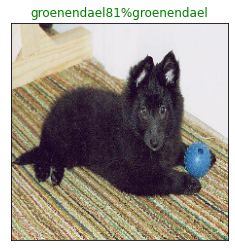

In [141]:
plot_pred(prediction_probabilities= prediction,
          labels=val_labels,
          images=val_images,
          n=77)

# Visualizing And Evaluate Model Predictions 2

Now we've got one function to visualize our models top prediction, let's make another to view our models top 10 predictions.

This function will:

* Take an input of prediction probabilities array and a ground truth array and an integer ✅
* Find the prediction using get_pred_label() ✅
* Find the top 10:
    * Prediction probabilities indexes ✅
    * Prediction probabilities values ✅
    * Prediction labels ✅
*Plot the top 10 prediction probability values and labels, coloring the true label green ✅

In [142]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

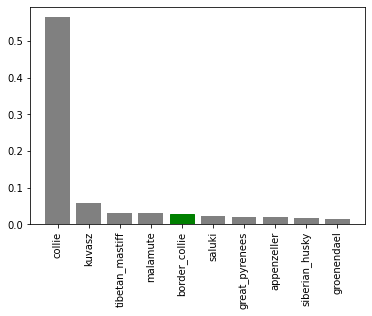

In [144]:
plot_pred_conf(prediction_probabilities=prediction,
               labels=val_labels,
               n=9)

# Visualizing And Evaluate  Model Predictions 3

Now we've got some function to help us visualize our predictions and evaluate our modle, let's check out a few.

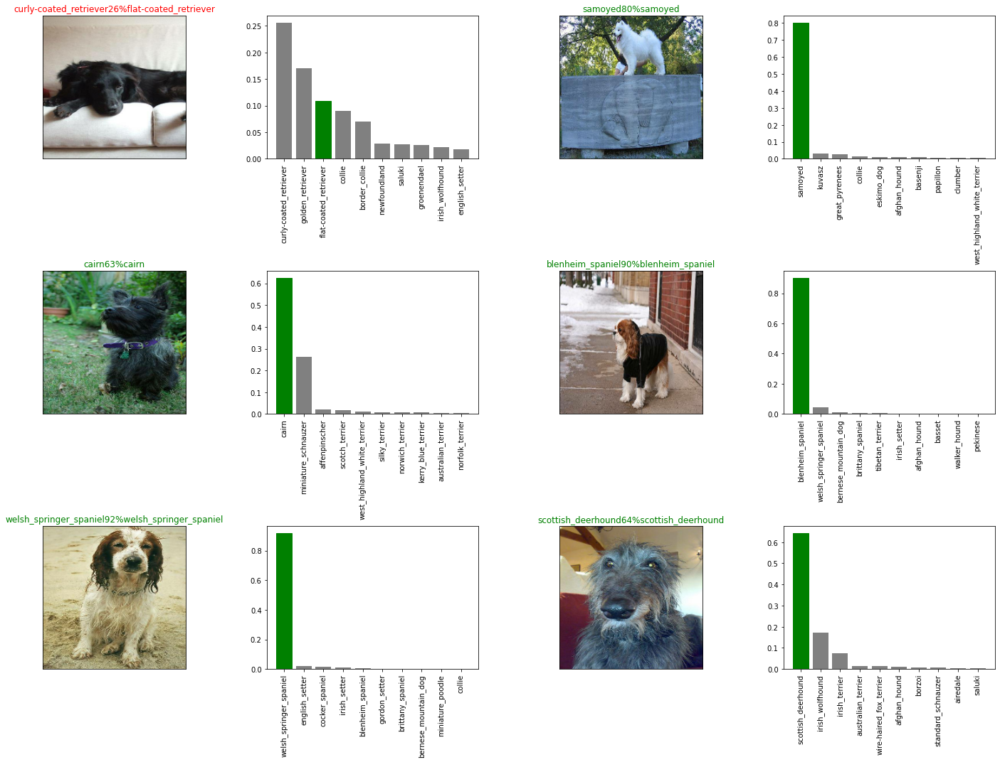

In [145]:
# Let's check out a few predictions and their different values
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

Challenge: How would you create a confusion matrix with our models predictions and true labels?

# Saving And Loading A Trained Model

In [149]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("drive/MyDrive/Dog vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [150]:
# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path, 
                                     custom_objects={"KerasLayer":hub.KerasLayer}) # we are using the special layer
  return model

Now we've got functions to save and load a trained model, let's make sure they work!

In [151]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog vision/models/20220707-10381657190321-1000-images-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog vision/models/20220707-10381657190321-1000-images-mobilenetv2-Adam.h5'

In [152]:
# Load a trained model
loaded_1000_image_model = load_model('drive/MyDrive/Dog vision/models/20220707-10381657190321-1000-images-mobilenetv2-Adam.h5')

Loading saved model from: drive/MyDrive/Dog vision/models/20220707-10381657190321-1000-images-mobilenetv2-Adam.h5


In [153]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 2s 329ms/step - loss: 1.2885 - accuracy: 0.6350


[1.2885388135910034, 0.6349999904632568]

In [154]:
# Evaluate the loaded model
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 2s 169ms/step - loss: 1.2885 - accuracy: 0.6350


[1.2885388135910034, 0.6349999904632568]

# Training Model On Full Dataset

## Training the big dog model 🐶 (on the full data)

In [155]:
len(X), len(y)

(10222, 10222)

In [156]:
X[:10]

['drive/MyDrive/Dog vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [157]:
y[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [158]:
# Create a data batch with the full data set
full_data = create_data_batches(X, y)

Creating training data batches...


In [159]:
full_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [160]:
# Create a model for full model
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [161]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data, so we can't monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

Note: Running the cell below will take a little while (maybe up to 30 minutes for the first epoch) because the GPU we're using in the runtime has to load all of the images into memory.

In [162]:
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 76s 204ms/step - loss: 1.3444 - accuracy: 0.6673
Epoch 2/100
320/320 [==============================] - 57s 178ms/step - loss: 0.4034 - accuracy: 0.8816
Epoch 3/100
320/320 [==============================] - 75s 234ms/step - loss: 0.2374 - accuracy: 0.9336
Epoch 4/100
320/320 [==============================] - 63s 198ms/step - loss: 0.1547 - accuracy: 0.9624
Epoch 5/100
320/320 [==============================] - 67s 208ms/step - loss: 0.1064 - accuracy: 0.9775
Epoch 6/100
320/320 [==============================] - 60s 187ms/step - loss: 0.0788 - accuracy: 0.9851
Epoch 7/100
320/320 [==============================] - 35s 110ms/step - loss: 0.0594 - accuracy: 0.9919
Epoch 8/100
320/320 [==============================] - 36s 111ms/step - loss: 0.0461 - accuracy: 0.9945
Epoch 9/100
320/320 [==============================] - 35s 110ms/step - loss: 0.0383 - accuracy: 0.9960
Epoch 10/100
320/320 [==============================] - 35s 110m

In [164]:
save_model(full_model, suffix="full-image-set-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog vision/models/20220707-11141657192449-full-image-set-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog vision/models/20220707-11141657192449-full-image-set-mobilenetv2-Adam.h5'

In [167]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/Dog vision/models/20220707-11141657192449-full-image-set-mobilenetv2-Adam.h5')

Loading saved model from: drive/MyDrive/Dog vision/models/20220707-11141657192449-full-image-set-mobilenetv2-Adam.h5



# Making Predictions On Test Images



##Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created create_data_batches() earlier which can take a list of filenames as input and conver them into Tensor batches.

To make predictions on the test data, we'll:

* Get the test image filenames. ✅
* Convert the filenames into test data batches using create_data_batches() and setting the test_data parameter to True (since the test data doesn't have labels). ✅
* Make a predictions array by passing the test batches to the predict() method called on our model.

In [175]:
# Load test image filenames
test_path = "drive/MyDrive/Dog vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]

['drive/MyDrive/Dog vision/test/dd5c5652d5d34e922af98c9b0295d909.jpg',
 'drive/MyDrive/Dog vision/test/e26d745f820e6b14cae26bb5def0648f.jpg',
 'drive/MyDrive/Dog vision/test/e00a1b26edd5cb7323e3b75ce37b36f6.jpg',
 'drive/MyDrive/Dog vision/test/e443bb594a89ab5fa1266748d6b41648.jpg',
 'drive/MyDrive/Dog vision/test/e137b0cd96051765c349377725c4696d.jpg',
 'drive/MyDrive/Dog vision/test/e55d2fced9eb7e46aef5bdb288145fa4.jpg',
 'drive/MyDrive/Dog vision/test/e699b20911a55abda3558c5bcd37443d.jpg',
 'drive/MyDrive/Dog vision/test/e3cfadb2543190f43da6bb5500c75578.jpg',
 'drive/MyDrive/Dog vision/test/e7b4b0e7d7d76f8dbd64920f34443b25.jpg',
 'drive/MyDrive/Dog vision/test/dcae38083c0e6a8afe15b6f0703bdefa.jpg']

In [176]:
len(test_filenames)

10357

In [177]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [178]:
test_data

<BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

Note: Calling predict() on our full model and passing it the test data batch will take a long time to run (about a ~1hr). This is because we have to process ~10,000+ images and get our model to find patterns in those images and generate predictions based on what its learned in the training dataset.

In [187]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 49s 152ms/step


In [189]:
# Save predictions (NumPy array) to csv file (for access later)
np.savetxt("drive/MyDrive/Dog vision/preds_array.csv", test_predictions, delimiter=",")

In [190]:
# Load predictions (NumPy array) from csv file
test_predictions = np.loadtxt("drive/MyDrive/Dog vision/preds_array.csv", delimiter=",")

In [191]:
test_predictions[:10]

array([[4.35167988e-13, 6.68645818e-15, 2.99145277e-08, ...,
        3.51890316e-03, 7.81881365e-11, 2.90338923e-15],
       [1.94681775e-07, 2.65381601e-08, 9.68519657e-07, ...,
        3.12311677e-05, 1.74716788e-05, 4.11685441e-08],
       [3.68950611e-13, 1.41707188e-10, 2.23706166e-12, ...,
        5.73923938e-12, 1.35073333e-06, 5.67218938e-09],
       ...,
       [7.03459648e-07, 2.22310777e-12, 1.11445120e-08, ...,
        3.88179378e-10, 7.20314119e-09, 1.49330811e-03],
       [3.26534355e-11, 1.43206725e-12, 7.61179120e-09, ...,
        1.19831469e-07, 1.09470557e-06, 1.46361119e-08],
       [2.52434185e-12, 6.92138099e-04, 1.50961063e-10, ...,
        5.62348532e-06, 9.43570153e-11, 2.43790019e-08]])

In [192]:
test_predictions.shape

(10357, 120)

# Submitting Model to Kaggle

##Preparing test dataset predictions for Kaggle
Looking at the Kaggle sample submission, we find that it wants our models prediction probaiblity outputs in a DataFrame with an ID and a column for each different dog breed. https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

To get the data in this format, we'll:

* Create a pandas DataFrame with an ID column as well as a column for each dog breed. ✅
* Add data to the ID column by extracting the test image ID's from their filepaths.
* Add data (the prediction probabilites) to each of the dog breed columns.
* Export the DataFrame as a CSV to submit it to Kaggle.

In [193]:
# ["id"] + list(unique_breeds)

In [194]:
# Create a pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [195]:
# Append test image ID's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["id"] = test_ids

In [196]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,dd5c5652d5d34e922af98c9b0295d909,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e26d745f820e6b14cae26bb5def0648f,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e00a1b26edd5cb7323e3b75ce37b36f6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e443bb594a89ab5fa1266748d6b41648,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e137b0cd96051765c349377725c4696d,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [197]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,dd5c5652d5d34e922af98c9b0295d909,4.351680e-13,6.686458e-15,2.991453e-08,1.014639e-11,3.311814e-10,2.660156e-11,1.950717e-14,2.158551e-10,1.921584e-10,...,3.748275e-11,5.197867e-06,4.150140e-08,2.803197e-11,8.203475e-11,2.925882e-15,1.866048e-10,3.518903e-03,7.818814e-11,2.903389e-15
1,e26d745f820e6b14cae26bb5def0648f,1.946818e-07,2.653816e-08,9.685197e-07,9.280714e-08,3.858326e-04,5.703837e-06,8.268272e-08,1.895889e-05,2.560504e-07,...,1.868296e-07,4.394508e-03,2.355935e-07,4.870049e-08,9.620951e-05,4.575676e-08,4.321134e-06,3.123117e-05,1.747168e-05,4.116854e-08
2,e00a1b26edd5cb7323e3b75ce37b36f6,3.689506e-13,1.417072e-10,2.237062e-12,4.506363e-08,7.048800e-11,4.764619e-11,3.992629e-08,9.664995e-10,7.903894e-07,...,2.779962e-11,2.036359e-12,7.455091e-07,5.053586e-06,8.916213e-11,3.033236e-11,3.329679e-12,5.739239e-12,1.350733e-06,5.672189e-09
3,e443bb594a89ab5fa1266748d6b41648,5.907838e-12,1.681572e-06,1.332955e-11,4.380983e-07,2.418659e-13,3.570641e-09,2.723653e-13,2.896445e-13,1.126368e-12,...,1.790133e-11,2.785695e-14,3.577272e-10,1.882024e-08,1.465392e-08,1.014134e-12,1.805372e-13,1.105286e-08,7.780317e-14,4.710265e-12
4,e137b0cd96051765c349377725c4696d,1.666310e-10,8.936715e-09,7.961234e-10,1.883900e-09,2.151274e-08,1.422438e-10,7.766826e-09,2.457858e-08,8.297149e-11,...,4.146164e-09,4.401161e-09,6.140547e-10,1.574820e-10,1.761281e-10,1.697205e-11,6.509953e-10,2.124841e-11,4.829876e-06,1.369565e-08


In [199]:
# Save our predictions dataframe to CSV for submission to Kaggle
preds_df.to_csv("drive/MyDrive/Dog vision/full_model_predictions_submission_1_mobilenetV2.csv",
                index=False)

# Making Predictions On Our Images

## Making predictions on custom images
To make predictions on custom images, we'll:

* Get the filepaths of our own images.
* Turn the filepaths into data batches using create_data_batches(). And since our custom images won't have labels, we set the test_data parameter to True.
* Pass the custom image data batch to our model's predict() method.
* Convert the prediction output probabilities to predictions labels.
* Compare the predicted labels to the custom images.

In [203]:
# Get custom image filepaths
custom_path = "drive/MyDrive/Dog vision/my-dog-photos/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [204]:
custom_image_paths

['drive/MyDrive/Dog vision/my-dog-photos/download.jpg',
 'drive/MyDrive/Dog vision/my-dog-photos/download (1).jpg']

In [205]:
# Turn custom images into batch datasets 
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [206]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

In [207]:
custom_preds.shape

(2, 120)

In [208]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['bull_mastiff', 'golden_retriever']

In [209]:
# Get custom images (our unbatchify() function won't work since there aren't labels... maybe we could fix this later)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

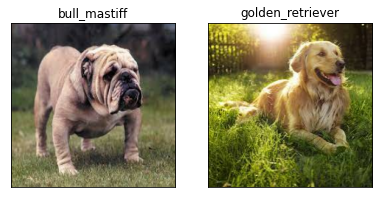

In [210]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)